# Imports

In [1]:
import os
import datetime
import numpy as np
import matplotlib.pyplot as plt
import PIL
plt.rcParams['figure.figsize'] = (25, 14)

import cv2
import pandas as pd
from sklearn.model_selection import train_test_split
import gc
gc.enable()
import random

import tensorflow as tf
import tensorflow.keras as keras

# Directory Structure

In [2]:
IMAGE_WIDTH = 256
IMAGE_HEIGHT = 256
DTYPE = np.float64
SEED = 42
BS = 16
def set_seed(SEED):
    np.random.seed(SEED)
    random.seed(SEED)
    tf.random.set_seed(SEED)

set_seed(SEED)

BASE_DIR = '/kaggle/input/kitti-dataset/'
LABEL_PATH = os.path.join(BASE_DIR,'data_object_label_2/training/label_2')
IMAGE_PATH = os.path.join(BASE_DIR,'data_object_image_2/training/image_2')
IMAGE_STEREO_PATH = os.path.join(BASE_DIR,'data_object_image_3/training')
CALIB_PATH = os.path.join(BASE_DIR,'data_object_calib/training/calib')

# Visualization

In [3]:
# source KITTI stater kit
images =  [(f) for f in os.listdir(IMAGE_PATH) if os.path.isfile(os.path.join(IMAGE_PATH, f))]
masks = [(f) for f in os.listdir(LABEL_PATH) if os.path.isfile(os.path.join(LABEL_PATH, f))]
masks.sort()


df = pd.DataFrame(np.column_stack([masks]), columns=['masks'])
df['images'] = df['masks'].apply(lambda x: x[:-3]+'png')


no_images = df[df['images'].apply(lambda i:  i not in images)]
if(len(no_images)>0):
    print("missing mask")
    print(no_images)
else:
    print("NO. missing mask")


    
img = cv2.imread(os.path.join(IMAGE_PATH, '000055.png') )    
print('Image shape: ', img.shape)
print(df.shape)
df.head()

NO. missing mask
Image shape:  (375, 1242, 3)
(7481, 2)


,masks,images
0,000000.txt,000000.png
1,000001.txt,000001.png
2,000002.txt,000002.png
3,000003.txt,000003.png
4,000004.txt,000004.png


In [4]:
def get_labels(label_filename):
    
    data =  pd.read_csv(os.path.join(LABEL_PATH,label_filename), sep=" ", 
                       names=['label', 'truncated', 'occluded', 'alpha', 
                              'bbox_xmin', 'bbox_ymin', 'bbox_xmax', 
                              'bbox_ymax', 'dim_height', 'dim_width', 'dim_length', 
                              'loc_x', 'loc_y', 'loc_z', 'rotation_y', 'score'])
    
    return data
    
get_labels('000055.txt')

,label,truncated,occluded,alpha,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax,dim_height,dim_width,dim_length,loc_x,loc_y,loc_z,rotation_y,score
0,Truck,0.0,0,-1.56,569.25,125.75,642.77,214.80,3.52,2.89,10.81,-0.18,1.71,34.15,-1.57,NaN
1,Car,0.0,1,2.24,31.61,193.32,129.71,230.77,1.48,1.35,3.93,-23.47,2.44,32.12,1.62,NaN
2,Car,0.0,1,2.14,104.42,188.01,188.34,220.56,1.50,1.62,4.08,-23.45,2.30,36.62,1.58,NaN
3,Car,0.0,1,2.08,183.23,187.33,245.86,217.54,1.65,1.57,3.82,-23.27,2.53,42.56,1.58,NaN
4,Car,0.0,1,2.04,227.36,189.17,281.98,211.96,1.37,1.36,4.44,-23.40,2.48,47.64,1.59,NaN
5,DontCare,-1.0,-1,-10.00,493.86,154.57,525.19,183.59,-1.00,-1.00,-1.00,-1000.00,-1000.00,-1000.00,-10.00,NaN
6,DontCare,-1.0,-1,-10.00,645.63,163.86,684.67,184.57,-1.00,-1.00,-1.00,-1000.00,-1000.00,-1000.00,-10.00,NaN


## Bounding Box

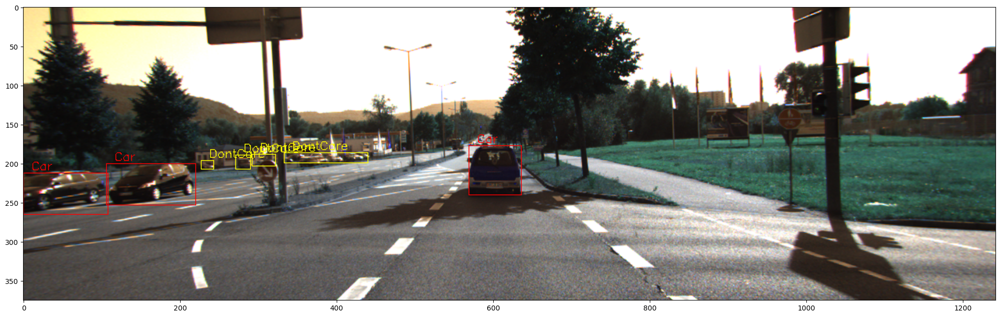

In [5]:
def open_image(image_filename):
    return cv2.imread(os.path.join(IMAGE_PATH, image_filename))
    
    
def draw_box2d_id(id):
    """
        To see what BoundingBoxes are for our dataset.
    """
    return draw_box2d(open_image(id + '.png'),
                      get_labels(id + '.txt'))

LABEL_COLORS = {
    'Car': (255,0,0), 
    'Van': (255,255,0), 
    'Truck': (255,255,255),
    'Pedestrian': (0,255,255),
    'Person_sitting': (0,255,255), 

    'Cyclist': (0,128,255), 
    'Tram': (128,0,0),
    'Misc': (0,255,255),
    'DontCare': (255,255,0)
}

def draw_box2d(image, labels, ax = None):
    """
        Function to draw 2D boxes for our model. 

        :param label_filename: filename like kitti_3d/{training,testing}/label_2/id.txt

        Returns a Pandas DataFrame.
    """
    img = image.copy()
    for index, row in labels.iterrows():
        left_corner = (int(row.bbox_xmin), int(row.bbox_ymin))
        right_corner = (int(row.bbox_xmax), int(row.bbox_ymax))
        label_color = LABEL_COLORS.get(row.label,(0,255,0))
        
        img = cv2.rectangle(img, 
                            left_corner, right_corner, label_color, 1)
        img = cv2.putText(img, str(row.label), 
                          (left_corner[0] + 10, left_corner[1] - 4) , 
                          cv2.FONT_HERSHEY_SIMPLEX, 0.5, 
                          label_color, 1)
    if ax == None:
        plt.imshow(img)
    else:
        ax.imshow(img)


draw_box2d_id('000101')

In [6]:
def get_image(path):
    return cv2.imread(path)

def create_mask(mask_dir, img_shape):

    mask = np.zeros(shape=(img_shape[0], img_shape[1], 1), dtype = DTYPE)
    

    with open(mask_dir) as f:
        content = f.readlines()
    content = [x.split() for x in content] 
    for item in content:
        if item[0]=='Car' or item[0]=='Truck' or item[0]=='Van' or item[0]=='Cyclist' or item[0]=='Tram' or item[0]=='Pedestrian' or item[0]=='Misc':
            ul_col, ul_row = int(float(item[4])), int(float(item[5]))
            lr_col, lr_row = int(float(item[6])), int(float(item[7]))
            
            mask[ul_row:lr_row, ul_col:lr_col, 0] = 1 
    return mask


def draw_mask(image, mask, ax = None):
    rgb_mask = np.repeat(mask, 3, axis = 2)
    img = cv2.addWeighted( image, 0.5, rgb_mask, 0.5, 0)
    if ax == None:
        plt.imshow(img)
    else:
        ax.imshow(img)
        
def draw_mask_by_id(id):
    img = np.array(get_image(os.path.join(IMAGE_PATH,id + '.png')) / 255.0, dtype = DTYPE) 
    mask = create_mask(os.path.join(LABEL_PATH,  id + '.txt'), img.shape )
    draw_mask(img,mask)
    plt.axis('off')
    plt.savefig(f"sample_{id}.svg", format='svg')
    plt.savefig(f"sample{id}.pdf", format='pdf')
    plt.show()

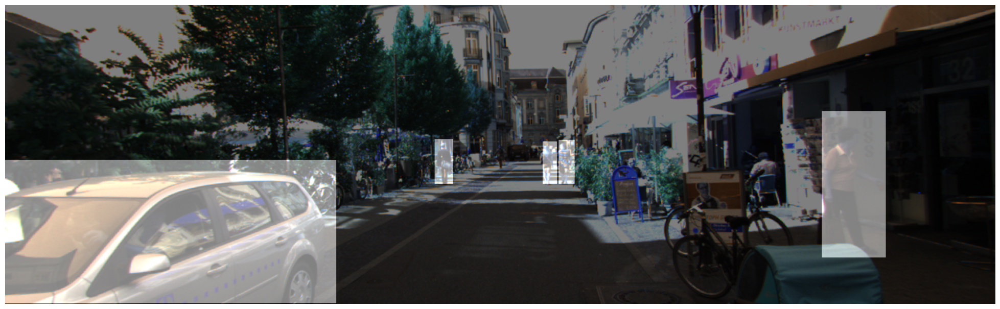

In [7]:
draw_mask_by_id('000015')
# draw_mask_by_id('000025')
# draw_mask_by_id('000035')
# draw_mask_by_id('000045')
# draw_mask_by_id('000055')
# draw_mask_by_id('000065')
# draw_mask_by_id('000075')

In [8]:
# old_df = df.copy()
# print(old_df.shape)

# df=old_df.sample(1000)
# print(df.shape)

# sample(frac=1)

In [9]:
df.shape

(7481, 2)

In [10]:
df.sample(5)

,masks,images
2825,002825.txt,002825.png
6358,006358.txt,006358.png
7115,007115.txt,007115.png
6566,006566.txt,006566.png
4604,004604.txt,004604.png


# DataGenerator

In [11]:
from abc import ABCMeta, abstractmethod
import imgaug as ia
import imgaug.augmenters as iaa
from imgaug.augmentables.segmaps import SegmentationMapsOnImage

ia.seed(42)

class DataGenerator(tf.keras.utils.Sequence):
    
    def __init__(self,indices, batch_size, shuffle):
        self.indices = indices
        self.batch_size = batch_size
        self.shuffle = shuffle
        
        self.on_epoch_end()
        
    def __len__(self):
        return len(self.indices) // self.batch_size

    def __getitem__(self, index):
        index = self.index[index * self.batch_size:(index + 1) * self.batch_size]
        batch = [self.indices[k] for k in index]
        
        return self.get_data(batch)
    
    def sample(self):
        return self[random.randint(0,len(self))]

    def on_epoch_end(self):
        self.index = np.arange(len(self.indices))
        if self.shuffle == True:
            np.random.shuffle(self.index)


In [12]:
class KittiDataGenerator(DataGenerator):
    
    def __init__(self, 
                 df,
                 shape = (IMAGE_WIDTH, IMAGE_HEIGHT),
                 
                 batch_size=BS, 
                 shuffle=True, 
                 
                 augmentation = None,
                 
                 image_col = 'images',
                 mask_col = 'masks',
                 
                 label_path = LABEL_PATH,
                 image_path = IMAGE_PATH
                ):
        
        self.df = df
        self.shape = shape

        self.image_col = image_col
        self.mask_col = mask_col
        self.label_path = label_path
        self.image_path = image_path
        self.augmentation = augmentation
        
        super().__init__(self.df.index.tolist(), batch_size, shuffle)
    
    def get_x(self, index):
        return get_image(
            os.path.join(self.image_path, self.df.loc[index][self.image_col])
        ) 
    
    def get_y(self, index, shape):
        return create_mask(os.path.join(self.label_path, self.df.loc[index][self.mask_col]),shape) 


    def get_data(self, batch):
        batch_X = []
        batch_y = []
        
        for i in batch:
            image_r = self.get_x(i)
            mask_r = self.get_y(i, image_r.shape)
            
            image_r = cv2.resize(image_r, (self.shape[0], self.shape[1]))
            mask_r = cv2.resize(mask_r,(self.shape[0], self.shape[1]))
            
            if self.augmentation is not None:
                mask_r = np.array(mask_r, dtype=np.int32)
                segmap = SegmentationMapsOnImage(mask_r, shape=image_r.shape)
                image_r, segmap = self.augmentation(image = image_r, segmentation_maps = segmap)
                mask_r = segmap.get_arr().astype(np.float64)
                
                
            batch_X.append(image_r)
            batch_y.append(mask_r)
        
        batch_X = np.array(batch_X)
        batch_y = np.array(batch_y)
        
        return batch_X / 255.0, batch_y

# ---------------Default -----------------
seq = iaa.Sequential([
    iaa.Dropout([0.00, 0.06]),      # drop 5% or 20% of all pixels
    iaa.Sharpen((0.0, 0.1)),       # sharpen the image
    iaa.Multiply((0.5, 1.0), per_channel=0.5), # brightness
    iaa.Affine(rotate=(-5, 5)),  # rotate by -45 to 45 degrees (affects segmaps)
    iaa.GammaContrast((0.5, 1.0))  
])
    
image_generator = KittiDataGenerator(df, 
                                     shape = (IMAGE_WIDTH, IMAGE_HEIGHT),
                                     augmentation = seq)
batch_X,batch_y = image_generator.sample()
print('Input : ', batch_X.shape, batch_X.dtype,' max: ', batch_X.max(),  
      '\nOutput: ', batch_y.shape, batch_y.dtype, ' max: ', batch_y.max())

Input :  (16, 256, 256, 3) float64  max:  0.9882352941176471 
Output:  (16, 256, 256) float64  max:  1.0


# Loss & Evaluation matries

In [13]:
def calc_IOU(y_true, y_pred, smooth=1):
    y_true_f = keras.layers.Flatten()(y_true)
    y_pred_f = keras.layers.Flatten()(y_pred)
    
    intersection = keras.backend.sum(y_true_f*y_pred_f)
    
    return (2*(intersection + smooth) / (keras.backend.sum(y_true_f) + keras.backend.sum(y_pred_f) + smooth))


def calc_IOU_loss(y_true, y_pred):
    return -calc_IOU(y_true, y_pred)

calc_IOU_loss(batch_y,batch_y) 

<tf.Tensor: shape=(), dtype=float32, numpy=-1.0000048>

In [14]:
# def dice_loss(y_true, y_pred):
#     numerator = 2 * tf.reduce_sum(y_true * y_pred)
#     denominator = tf.reduce_sum(y_true + y_pred)
#     return 1 - numerator / denominator

# def iou_loss(y_true, y_pred):
#     intersection = tf.reduce_sum(y_true * y_pred)
#     union = tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) - intersection
#     return 1 - intersection / union

# def binary_crossentropy(y_true, y_pred):
#     return tf.keras.losses.binary_crossentropy(y_true, y_pred)

# iou_loss(batch_y,batch_y)

In [15]:
# def dice_coefficient(y_true, y_pred):
#     numerator = 2 * tf.reduce_sum(y_true * y_pred)
#     denominator = tf.reduce_sum(y_true + y_pred)
#     return numerator / denominator

# def iou(y_true, y_pred):
#     intersection = tf.reduce_sum(y_true * y_pred)
#     union = tf.reduce_sum(y_true) + tf.reduce_sum(y_pred)- intersection
#     return intersection / union

def accuracy(y_true, y_pred):
    return tf.keras.metrics.binary_accuracy(y_true, y_pred)

# Show Data

In [16]:
!mkdir 'augs'

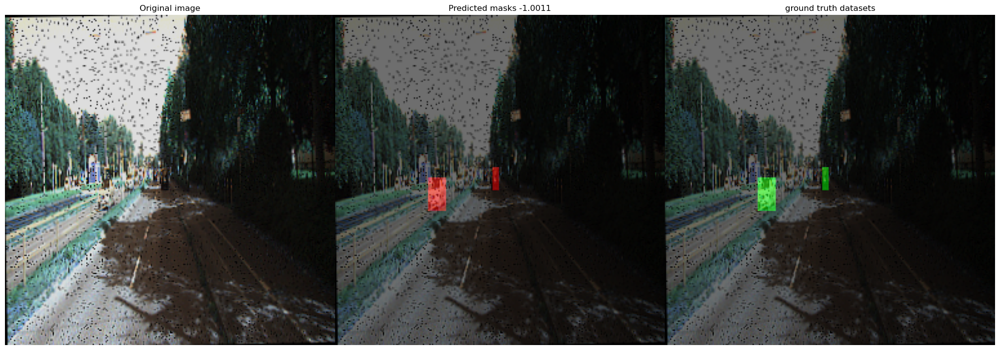

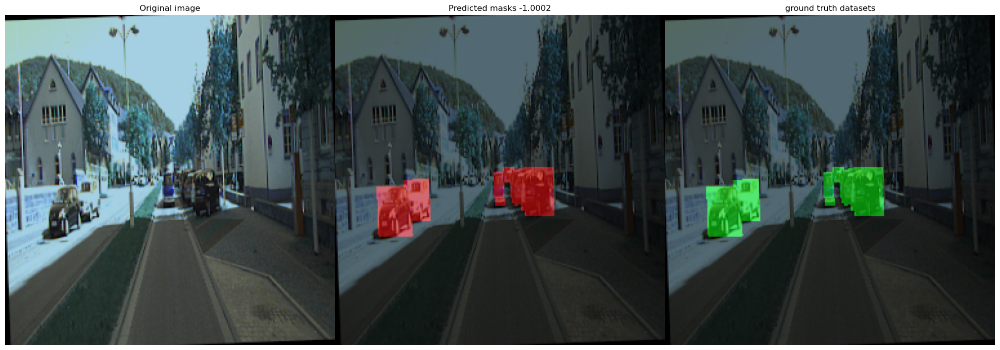

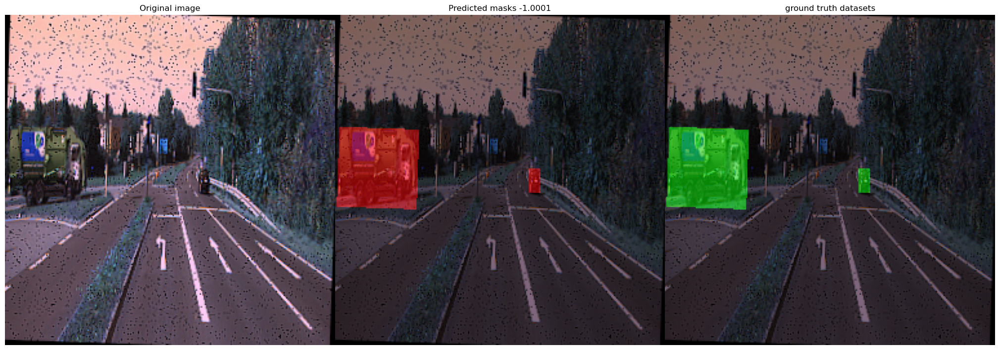

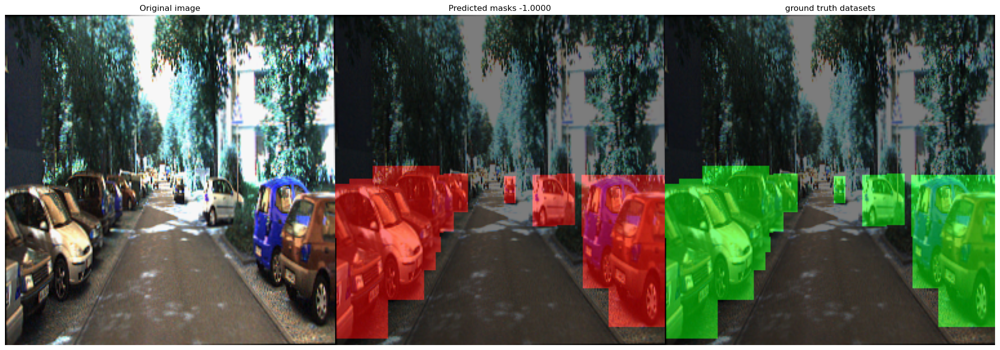

In [17]:
def show_data(X,y, y_pred = None):
    if y_pred is None:
        y_pred = y
    idx = 1    
    for x_i,y_i,y_pred_i in zip(X,y,y_pred):
        im = np.array(255*x_i,dtype=np.uint8)
        im_mask = np.array(255*y_i,dtype=np.uint8)
        im_pred = np.array(255*y_pred_i,dtype=np.uint8)
        im_pred1 = np.array(255*y_pred_i,dtype=np.uint8)

        rgb_mask_pred = cv2.cvtColor(im_pred,cv2.COLOR_GRAY2RGB)
        rgb_mask_pred1 = cv2.cvtColor(im_pred,cv2.COLOR_GRAY2RGB)
        temp1 = rgb_mask_pred[:,:,1:3]
        temp2 = rgb_mask_pred[:,:,1:2]
        rgb_mask_pred[:,:,1:3] = 0*rgb_mask_pred[:,:,1:3]
        rgb_mask_true= cv2.cvtColor(im_mask,cv2.COLOR_GRAY2RGB)
        rgb_mask_true[:,:,0] = 0*rgb_mask_true[:,:,0]
        rgb_mask_true[:,:,2] = 0*rgb_mask_true[:,:,2]
        
#         print(im.shape, rgb_mask_pred.shape)

        img_pred = cv2.addWeighted(rgb_mask_pred,0.5,im,0.5,0)
        img_true = cv2.addWeighted(rgb_mask_true,0.5,im,0.5,0)
        
        loss = calc_IOU_loss(np.array([y_i]),np.array([y_pred_i]))
        
        plt.figure(figsize=(20,8))
        plt.subplot(1,3,1)
        plt.imshow(im)
        plt.title('Original image')
        plt.axis('off')
        plt.subplot(1,3,2)
        plt.imshow(img_pred)
        plt.title(f'Predicted masks {loss:0.4f}')
        plt.axis('off')
        plt.subplot(1,3,3)
        plt.imshow(img_true)
        plt.title('ground truth datasets')
        plt.axis('off')
        plt.tight_layout(pad=0)
        plt.savefig(f"/kaggle/working/augs/{idx}.pdf", format='pdf')
        idx = idx+1
        plt.show()

show_data(batch_X[:4], batch_y[:4])

# Split Data

In [18]:
df_train, df_val = train_test_split(df, test_size=0.25, random_state=42, shuffle=True)
df_train.shape

(5610, 2)

In [19]:
5610 // BS , df_val.shape[0] // BS

(350, 116)

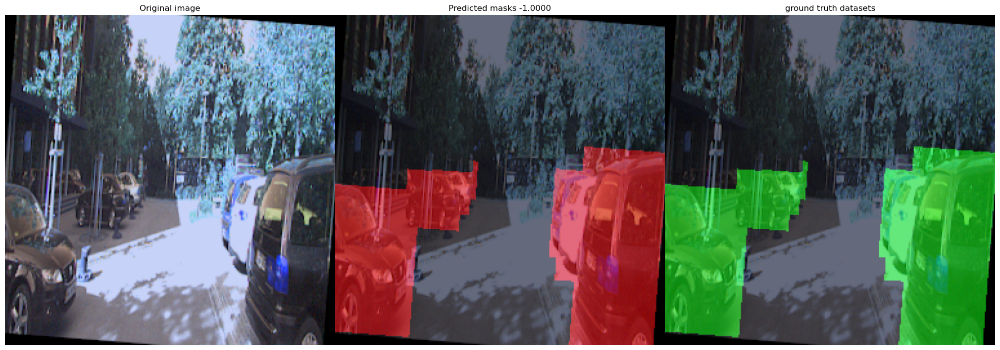

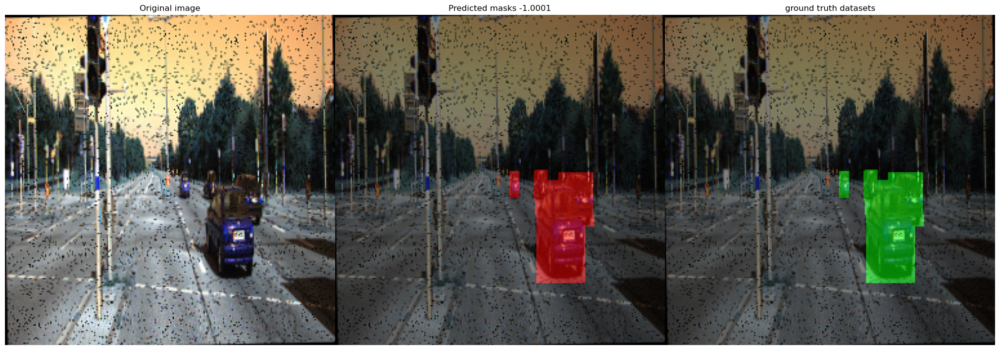

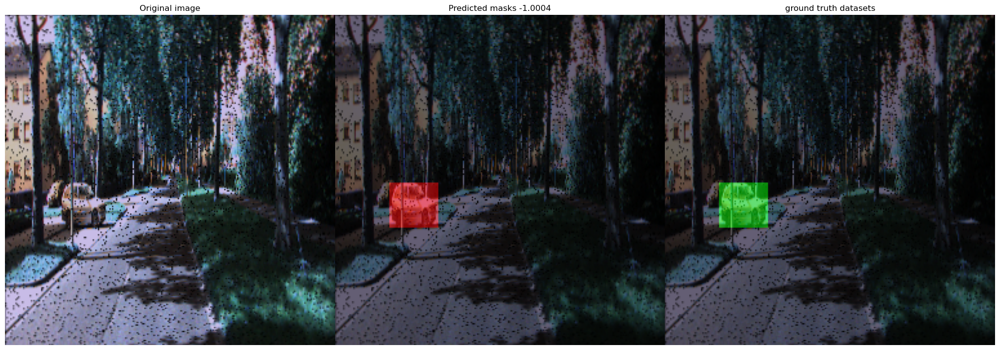

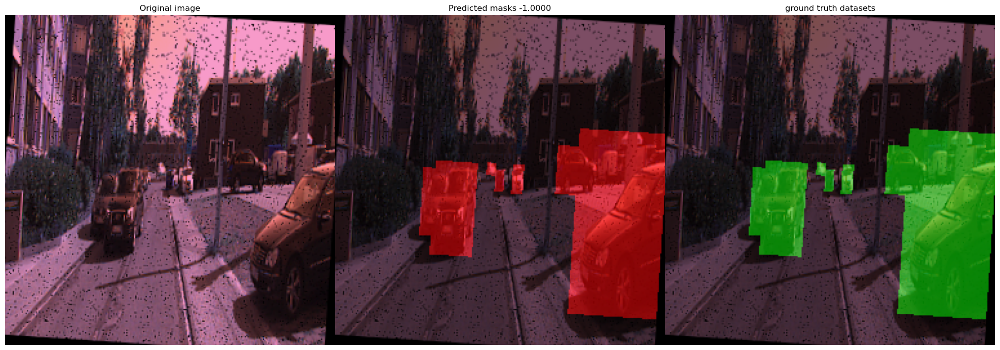

In [20]:
kitti_train = KittiDataGenerator(df_train,
                                 shape = (IMAGE_WIDTH, IMAGE_HEIGHT),
                                 augmentation = seq)

kitti_val =  KittiDataGenerator(df_val,
                                 shape = (IMAGE_WIDTH, IMAGE_HEIGHT))

batch_X, batch_y = kitti_train.sample()
show_data(batch_X[:4], batch_y[:4])

- https://github.com/jakugel/unet-variants/blob/main/unet_variant_models.py
- https://github.com/ashishpatel26/satellite-Image-Semantic-Segmentation-Unet-Tensorflow-keras
- https://github.com/nikhilroxtomar/Retina-Blood-Vessel-Segmentation-using-UNET-in-TensorFlow/blob/main/metrics.py
- https://github.dev/ashishpatel26/satellite-Image-Semantic-Segmentation-Unet-Tensorflow-keras


# Models Creation

In [21]:
import tensorflow as tf 
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Model,load_model
from tensorflow.keras.utils import load_img,img_to_array,plot_model 
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint,\
    EarlyStopping,Callback
from tensorflow.keras.layers import Conv2DTranspose,ZeroPadding2D,Conv2D,add,\
    Dropout,Input,concatenate,MaxPooling2D,UpSampling2D,BatchNormalization,AveragePooling2D

from tensorflow.keras.layers import Conv2D, MaxPooling2D, concatenate, Conv2DTranspose
from tensorflow.keras.layers import BatchNormalization, Input, Activation, Add, \
    GlobalAveragePooling2D, Reshape, Dense, multiply, Permute, maximum, Concatenate, Multiply

In [22]:
!pip install livelossplot --quiet

# Proposed Model

In [23]:
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Concatenate, Add, Multiply, ConvLSTM2D, BatchNormalization

from tensorflow.keras.models import Model

def attention_layer(g, x):
    conv_g = Conv2D(filters=x.shape[-1], kernel_size=1, strides=1, padding='same')(g)
    conv_x = Conv2D(filters=x.shape[-1], kernel_size=1, strides=1, padding='same')(x)
    f = Add()([conv_x, conv_g])
    f = tf.keras.activations.sigmoid(f)
    output = Multiply()([x, f])

    return output


def conv_block(input_layer, filters):
    x = Conv2D(filters=filters, kernel_size=3, strides=1,kernel_initializer='he_normal',padding='same')(input_layer)
    x = BatchNormalization()(x)
    x = tf.keras.activations.relu(x)
        
    x = Conv2D(filters=filters, kernel_size=3, strides=1,kernel_initializer='he_normal',padding='same')(x)
    x = BatchNormalization()(x)
    x = tf.keras.activations.relu(x)
    
    return x

def rnn_block(input_layer):
    x = tf.expand_dims(input_layer, axis=0)  # Add time steps dimension
    x = ConvLSTM2D(filters=input_layer.shape[-1], kernel_size=3, strides=1, padding='same', return_sequences=True)(x)
    x = BatchNormalization()(x)
    x = tf.squeeze(x, axis=0)  # Remove time steps dimension
    
    return x



def unet_with_attention_rnn(input_size=(256, 256, 3)):

    inputs = Input(input_size)

    c1 = conv_block(inputs, 64)
    p1 = MaxPooling2D(pool_size=(2, 2))(c1)
    
    c2 = conv_block(p1, 128)
    p2 = MaxPooling2D(pool_size=(2, 2))(c2)
    
    c3 = conv_block(p2, 256)
    p3 = MaxPooling2D(pool_size=(2, 2))(c3)

    # New Convolutional layer of 512 filters
    c4 = conv_block(p3, 512)
    p4 = MaxPooling2D(pool_size=(2, 2))(c4)

    # RNN path
    r = rnn_block(p4)
    
    # Decoding path
    u5 = UpSampling2D(size=(2, 2))(r)
    a5 = attention_layer(g=u5, x=c4)
    concat5 = Concatenate()([u5, a5])
    c5 = conv_block(concat5, 512)

    u6 = UpSampling2D(size=(2, 2))(c5)
    a6 = attention_layer(g=u6, x=c3)
    concat6 = Concatenate()([u6, a6])
    c6 = conv_block(concat6, 256)
    
    u7 = UpSampling2D(size=(2, 2))(c6)
    a7 = attention_layer(g=u7, x=c2)
    concat7 = Concatenate()([u7, a7])
    c7 = conv_block(concat7, 128)

    u8 = UpSampling2D(size=(2, 2))(c7)
    a8 = attention_layer(g=u8, x=c1)
    concat8 = Concatenate()([u8, a8])
    c8 = conv_block(concat8, 64)

    # Output layer
    output = Conv2D(filters=1, kernel_size=1, strides=1, activation='sigmoid', padding='same')(c8)
    model = Model(inputs=inputs, outputs=output, name='ASDE-Net')

    return model

unet_model = unet_with_attention_rnn()

unet_model.summary()

Model: "ASDE-Net"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 64  256        ['conv2d[0][0]']                 
 alization)                     )                                                          

In [24]:
from tensorflow.keras import backend as K


def iou(y_true, y_pred):
    def f(y_true, y_pred):
        intersection = (y_true * y_pred).sum()
        union = y_true.sum() + y_pred.sum() - intersection
        x = (intersection + 1e-15) / (union + 1e-15)
        x = x.astype(np.float32)
        return x
    return tf.numpy_function(f, [y_true, y_pred], tf.float32)

smooth = 1e-15
def dice_coef(y_true, y_pred):
    y_true = tf.keras.layers.Flatten()(y_true)
    y_pred = tf.keras.layers.Flatten()(y_pred)
    intersection = tf.reduce_sum(y_true * y_pred)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + smooth)

def dice_loss(y_true, y_pred):
    return 1.0 - dice_coef(y_true, y_pred)

In [25]:
!pip install tensorflow_addons

from keras import backend as K
import tensorflow_addons as tfa

def f1_score(y_true, y_pred): 
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    recall = true_positives / (possible_positives + K.epsilon())
    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val

In [26]:
def accuracy(y_true, y_pred):
    return tf.keras.metrics.binary_accuracy(y_true, y_pred)

In [27]:
from livelossplot.tf_keras import PlotLossesCallback
# from livelossplot import PlotLossesKeras

In [28]:
!mkdir "train"

In [29]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger, ReduceLROnPlateau, EarlyStopping, TensorBoard

from tensorflow.keras.metrics import Recall, Precision, IoU,MeanIoU,BinaryIoU, BinaryAccuracy


unet_model.compile(optimizer=Adam(lr=1e-4),
                   loss=dice_loss, 
                   metrics=[
                       accuracy, 
                       dice_coef, 
                       iou, 
                       BinaryIoU(),
                       MeanIoU(2), 
                       Recall(), 
                       Precision(), 
                       f1_score])

In [30]:
model_path = "kaggle/working/train/model_form_Checkpoint.h5"
csv_path = "kaggle/working/train/trainInfo.csv"
TB_log_dir = "kaggle/working/train/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

In [31]:
CallbackList = [
        ModelCheckpoint(model_path, monitor='val_accuracy', verbose=1,save_weights_only=True, save_best_only=True, mode='max'),
        ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, min_lr=1e-7, verbose=1),
        EarlyStopping(monitor='val_loss', patience=5, mode="min", restore_best_weights=False),
        CSVLogger(csv_path),
        TensorBoard(log_dir=TB_log_dir, histogram_freq=1),
        PlotLossesCallback()
    ]

# Fiting the model

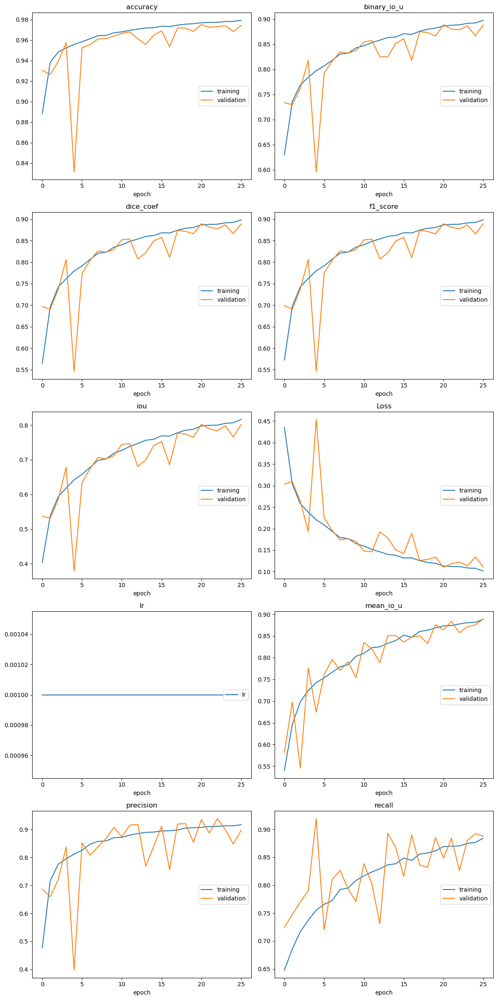

accuracy
	training         	 (min:    0.888, max:    0.979, cur:    0.979)
	validation       	 (min:    0.831, max:    0.975, cur:    0.974)
binary_io_u
	training         	 (min:    0.629, max:    0.898, cur:    0.898)
	validation       	 (min:    0.596, max:    0.889, cur:    0.888)
dice_coef
	training         	 (min:    0.565, max:    0.898, cur:    0.898)
	validation       	 (min:    0.546, max:    0.889, cur:    0.889)
f1_score
	training         	 (min:    0.572, max:    0.898, cur:    0.898)
	validation       	 (min:    0.546, max:    0.889, cur:    0.889)
iou
	training         	 (min:    0.404, max:    0.817, cur:    0.817)
	validation       	 (min:    0.379, max:    0.802, cur:    0.802)
Loss
	training         	 (min:    0.102, max:    0.435, cur:    0.102)
	validation       	 (min:    0.111, max:    0.454, cur:    0.111)
lr
	lr               	 (min:    0.001, max:    0.001, cur:    0.001)
mean_io_u
	training         	 (min:    0.540, max:    0.888, cur:    0.888)
	validation   

In [32]:
model_history =  unet_model.fit(
        kitti_train,
        steps_per_epoch=len(kitti_train),
        validation_data=kitti_val,
        validation_steps = len(kitti_val),
        epochs=321,
        callbacks=CallbackList)

In [33]:
hist_df = pd.DataFrame(model_history.history)
hist_csv_file = 'history.csv'
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

In [34]:
unet_model.save('/kaggle/working/ASDE_NET.h5')

In [35]:
X_batch, y_batch = kitti_val.sample()

print(X_batch.shape)

(16, 256, 256, 3)


In [36]:
y_batch_pred = unet_model.predict(X_batch)

print(X_batch.shape, y_batch.shape, y_batch_pred[:,:,:,0].shape)

print(calc_IOU_loss(y_batch,y_batch_pred))

1/1 [==============================] - 1s 712ms/step
(16, 256, 256, 3) (16, 256, 256) (16, 256, 256)
tf.Tensor(-0.86192733, shape=(), dtype=float32)


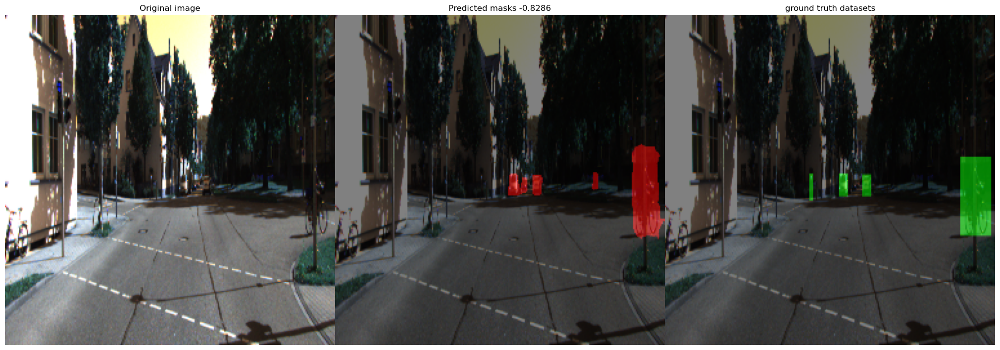

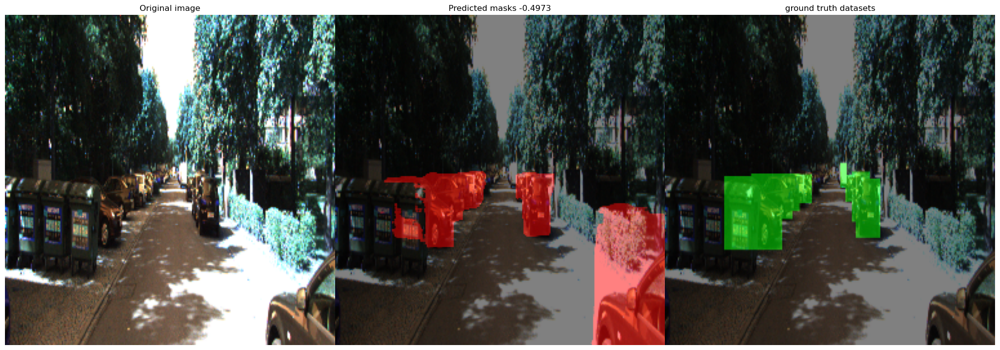

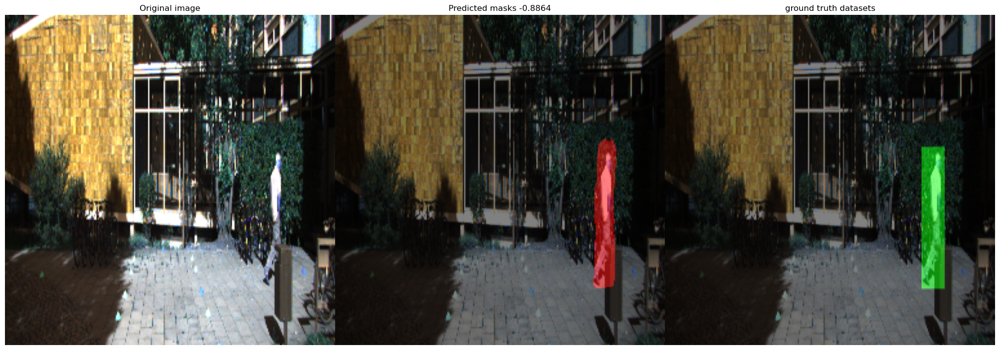

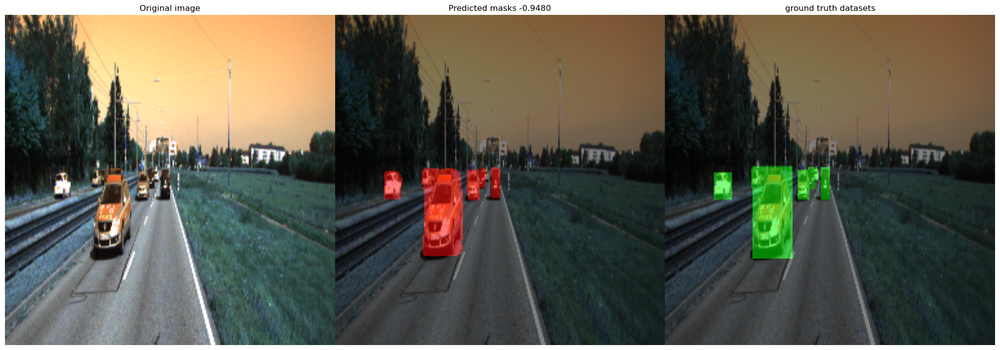

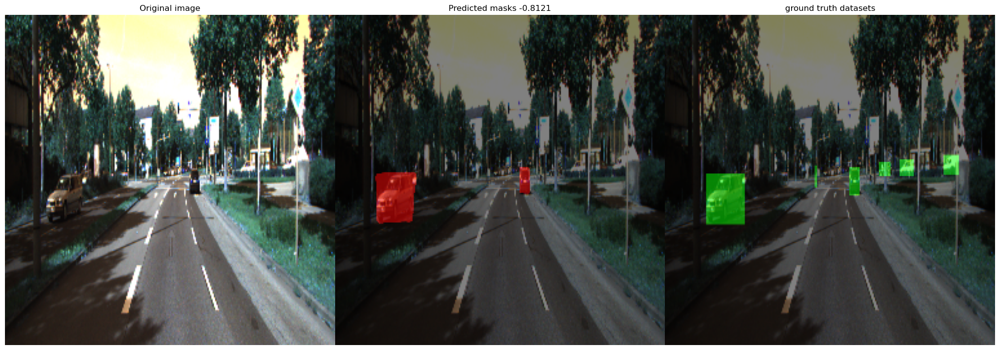

...

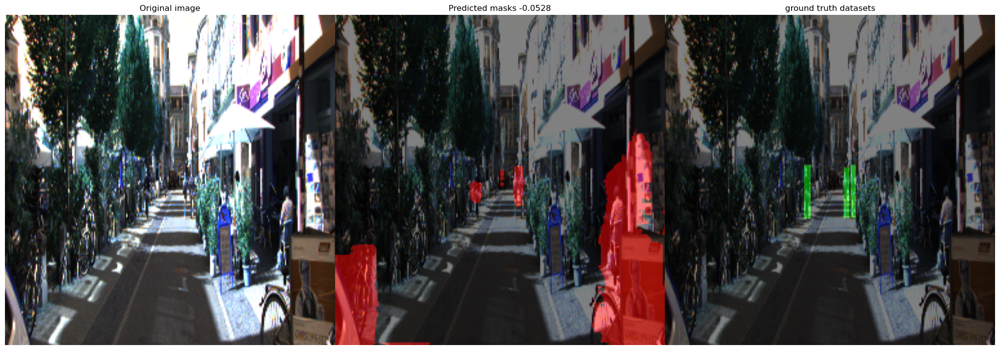

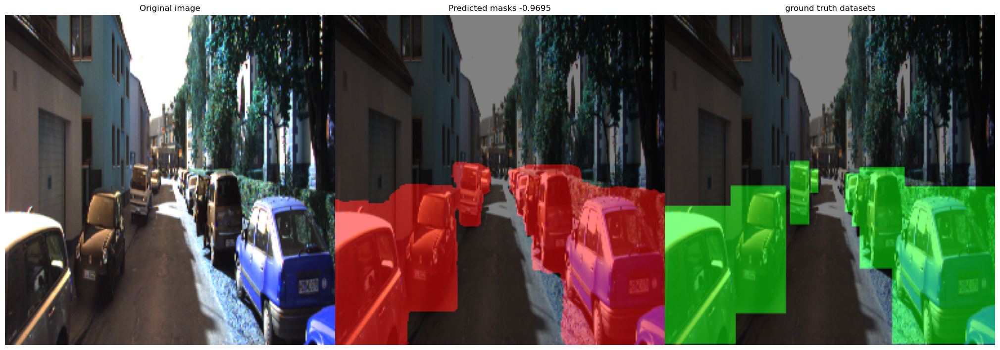

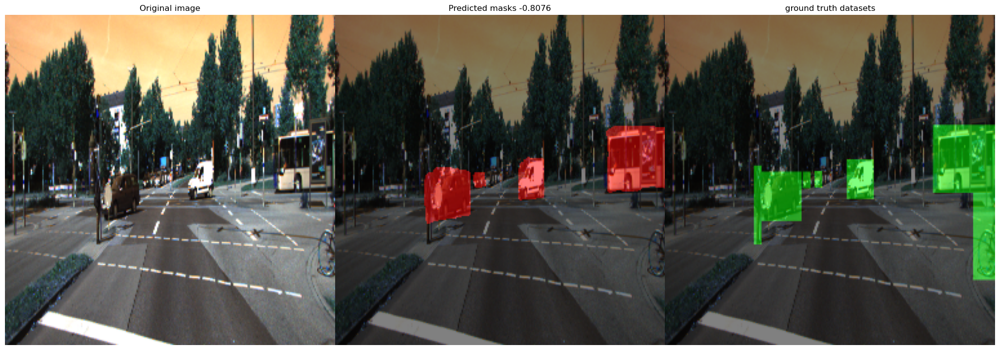

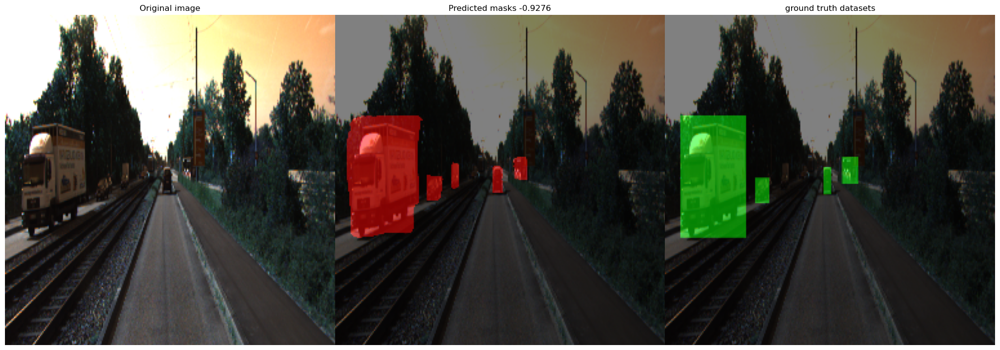

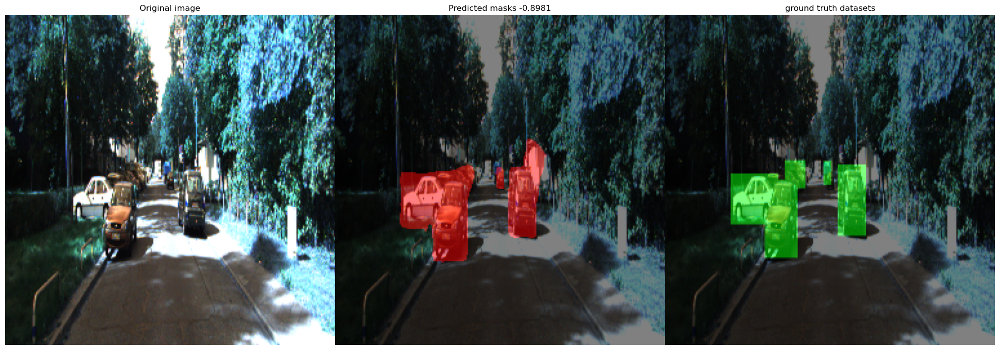

In [37]:
show_data(X_batch, y_batch, y_batch_pred[:,:,:,0])